In [1]:
%load_ext autoreload
%autoreload 2

In [2]:
import os
import sys
from pathlib import Path

ROOT = Path(os.getcwd())
while not (ROOT / ".git").exists():
    ROOT = ROOT.parent

sys.path.append(str(ROOT))

from src.config import CargoBikeConfig, load_config
from src.osm_tags import build_tag_filter
import src.load_data as cb_load
import src.plot.clusters as cb_plot

import polars as pl
import geopolars as gpl
import geopandas as gpd
import pandas as pd

## Load Config and Data


In [3]:
config = load_config(ROOT / "config" / "paper.yaml")
h3_df = cb_load.load_h3_data(config.Cities, ROOT / "data/geovex/clusters_4.parquet")
service_time_df = cb_load.process_all_city_data(
    config.Cities, config.ServiceTime, ROOT / "data/geovex/clusters_4.parquet"
)

### Plot the Service Time Distribution & Clusters


(<Figure size 4800x2400 with 2 Axes>,
 array([<Axes: >, <Axes: xlabel='Cluster', ylabel='Service Time (s)'>],
       dtype=object))

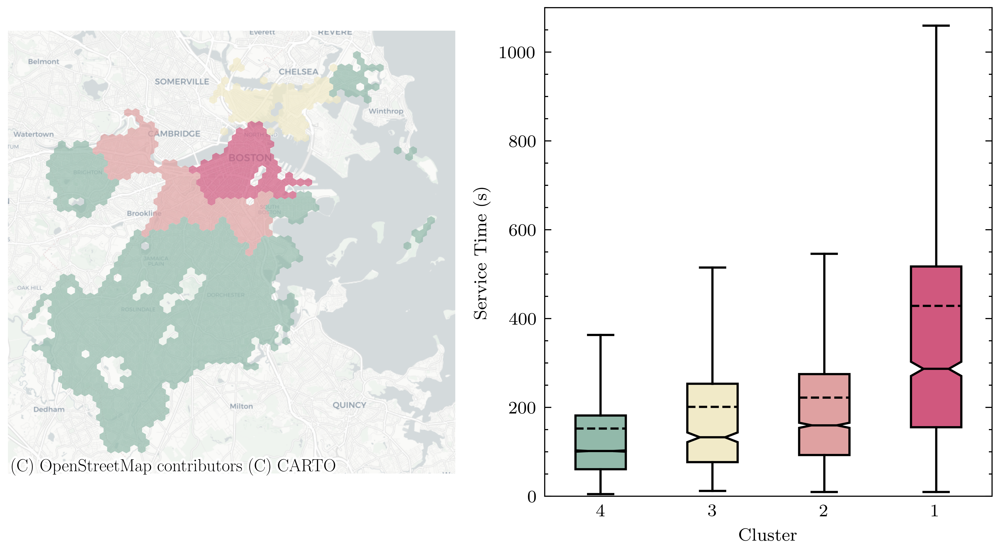

In [4]:
cb_plot.plot_city(
    service_time_df,
    h3_df,
    "Boston, USA",
    xaxis_title="Predicted Van Service Time [s]",
    max_service_time=1100,
)

(<Figure size 4800x3600 with 4 Axes>,
 array([[<Axes: title={'center': 'Boston, USA'}>,
         <Axes: xlabel='Cluster', ylabel='Service Time (s)'>],
        [<Axes: title={'center': 'Seattle, USA'}>,
         <Axes: xlabel='Cluster', ylabel='Service Time (s)'>]],
       dtype=object))

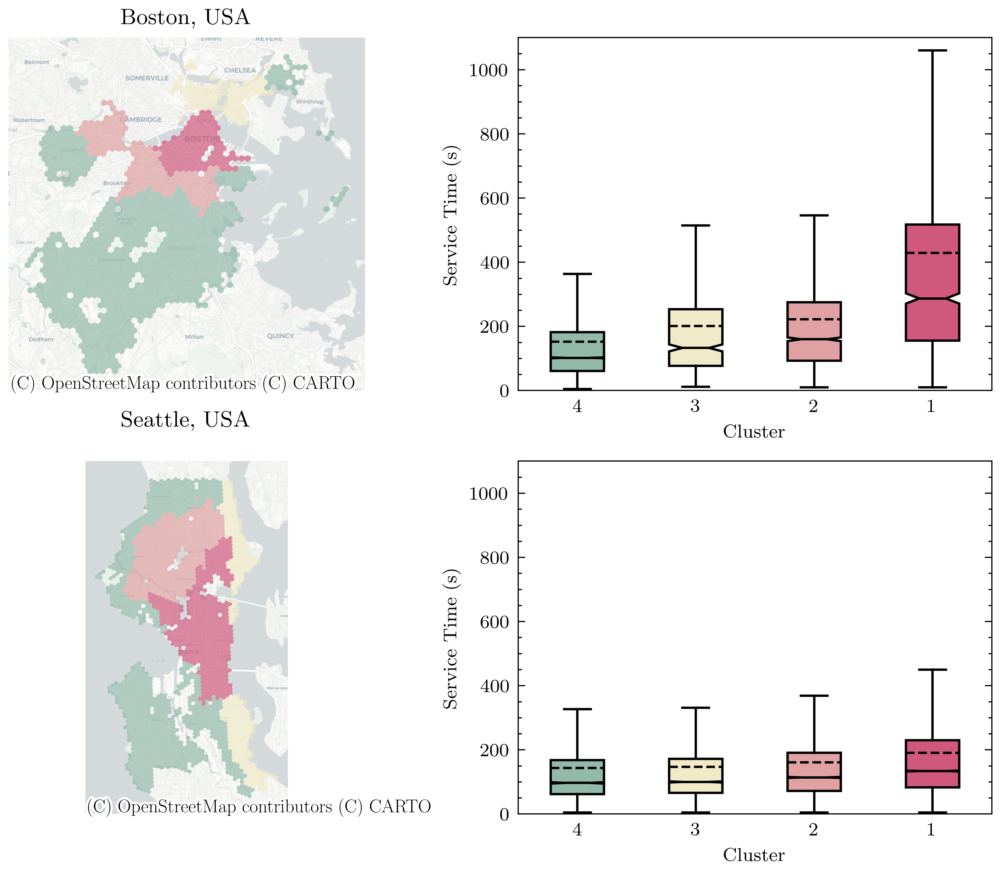

In [5]:
cb_plot.plot_cities(
    ["Boston, USA", "Seattle, USA"],
    service_time_df,
    h3_df,
    xaxis_title="Predicted Van Service Time [s]",
    max_service_time=1100,
)

(<Figure size 4800x3600 with 4 Axes>,
 array([[<Axes: title={'center': 'Boston, USA'}>,
         <Axes: xlabel='Cluster', ylabel='Service Time (s)'>],
        [<Axes: title={'center': 'Seattle, USA'}>,
         <Axes: xlabel='Cluster', ylabel='Service Time (s)'>]],
       dtype=object))

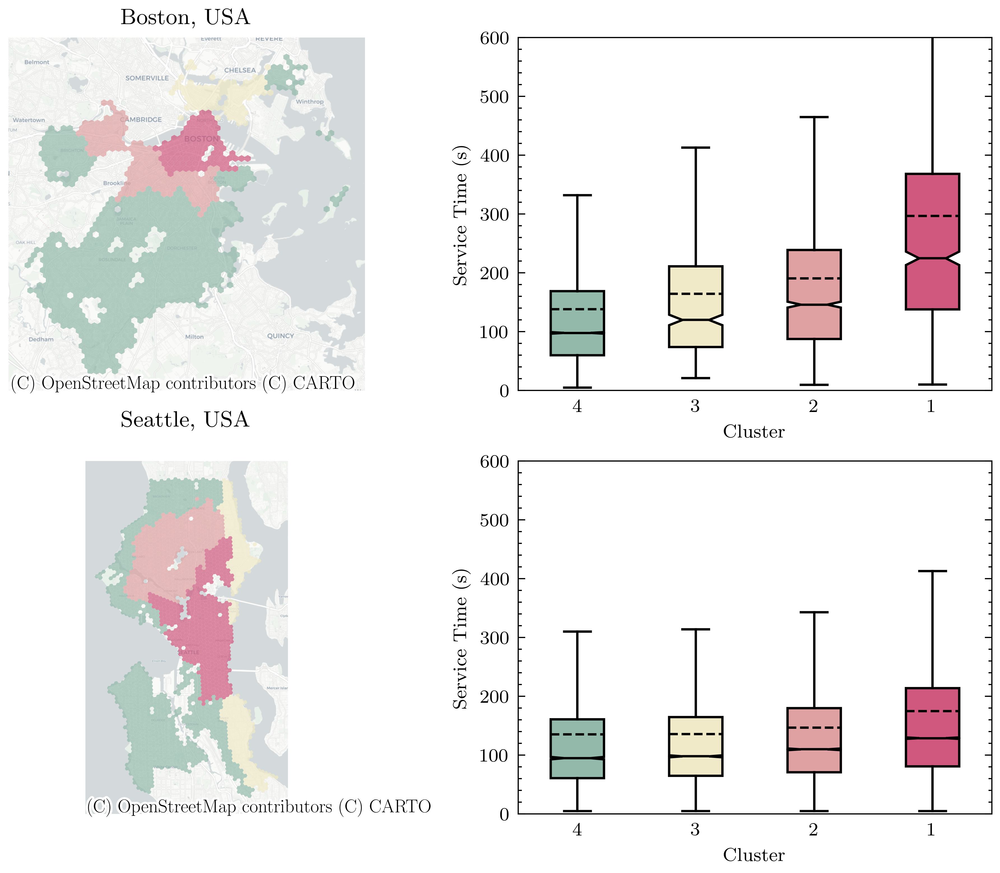

In [6]:
cb_plot.plot_cities(
    ["Boston, USA", "Seattle, USA"],
    service_time_df.filter(pl.col("package_num") <= 5),
    h3_df,
    xaxis_title="Predicted Van Service Time [s]",
)

(<Figure size 4800x3600 with 4 Axes>,
 array([[<Axes: title={'center': 'Brussels, Belgium'}>,
         <Axes: xlabel='Cluster', ylabel='Service Time (s)'>],
        [<Axes: title={'center': 'London, UK'}>,
         <Axes: xlabel='Cluster', ylabel='Service Time (s)'>]],
       dtype=object))

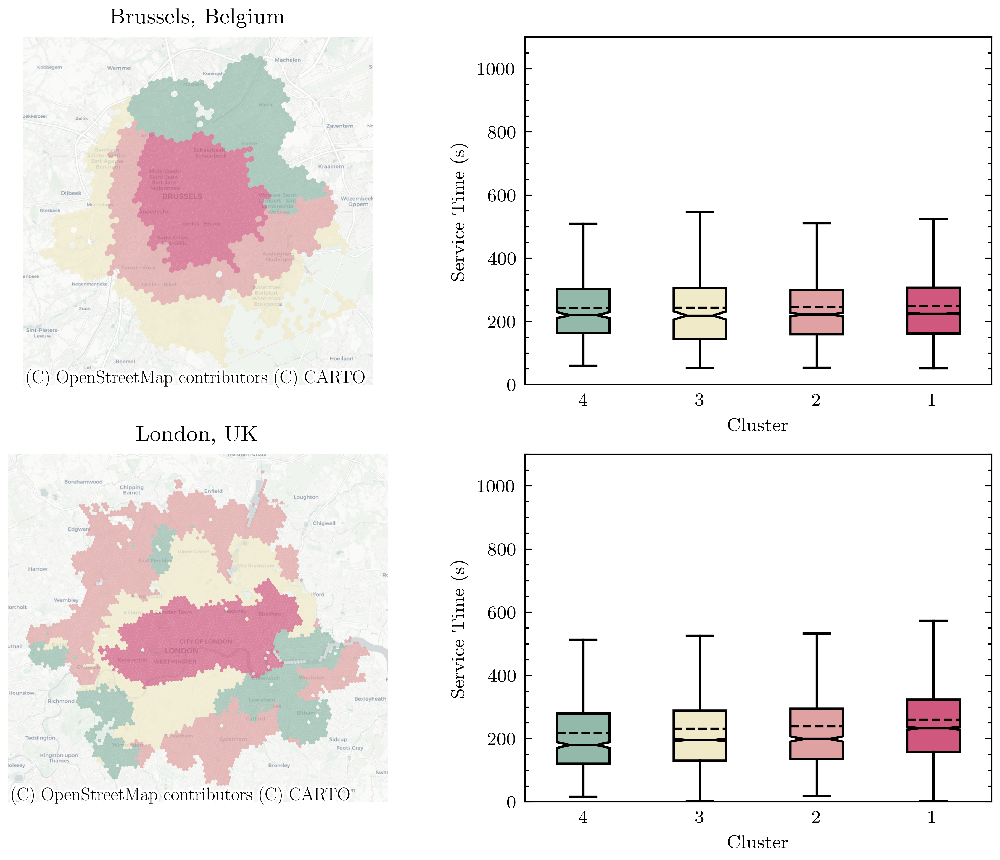

In [8]:
cb_plot.plot_cities(
    ["Brussels, Belgium", "London, UK"],
    service_time_df,
    h3_df,
    xaxis_title="Measured Bike Service Time [s]",
    max_service_time=1100,
)

(<Figure size 4800x2400 with 2 Axes>,
 array([<Axes: >,
        <Axes: xlabel='Predicted Van Service Time [s]', ylabel='Probability'>],
       dtype=object))

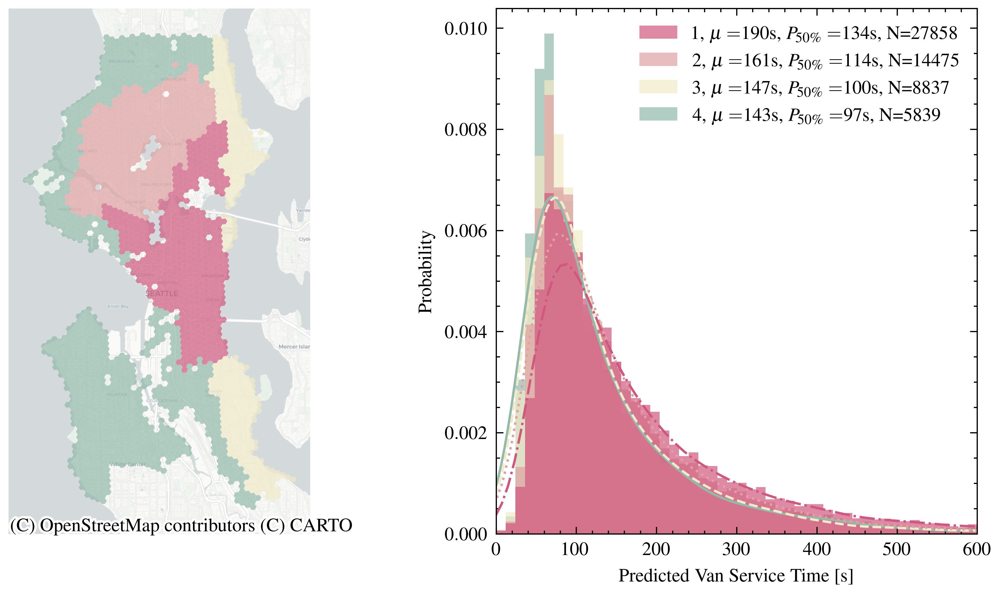

In [41]:
city = "Seattle, USA"
cb_plot.plot_city(
    service_time_df, h3_df, city, xaxis_title="Predicted Van Service Time [s]"
)

(<Figure size 4800x2400 with 2 Axes>,
 array([<Axes: >,
        <Axes: xlabel='Measured Cargo-Bike Service Time [s]', ylabel='Probability'>],
       dtype=object))

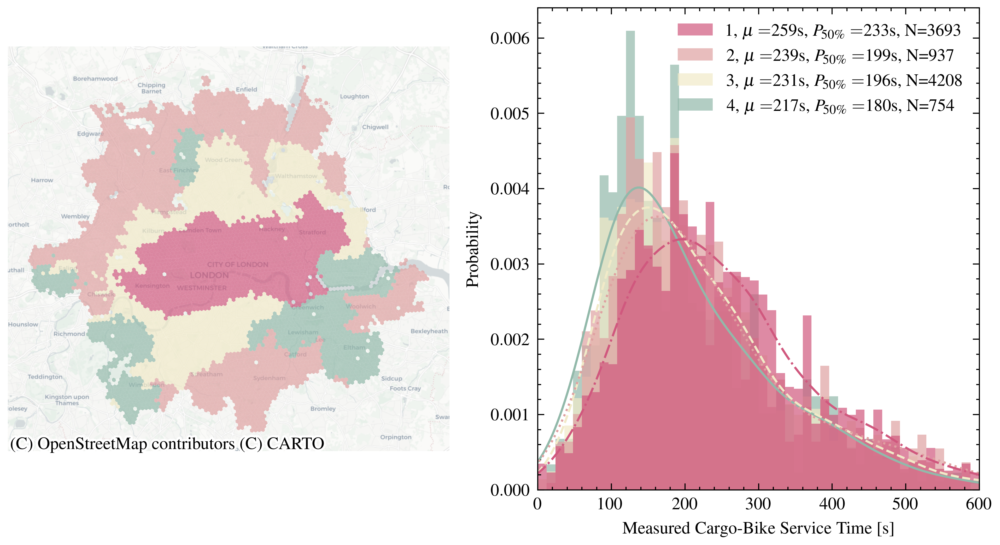

In [40]:
city = "London, UK"
cb_plot.plot_city(
    service_time_df, h3_df, city, xaxis_title="Measured Cargo-Bike Service Time [s]"
)

(<Figure size 4800x2400 with 2 Axes>,
 array([<Axes: >, <Axes: xlabel='Service Time [s]', ylabel='Probability'>],
       dtype=object))

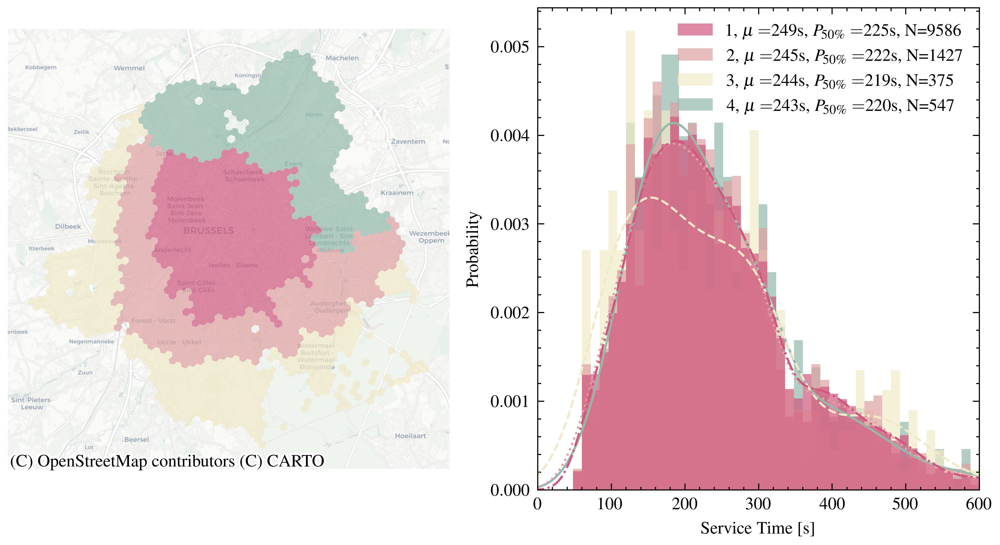

In [42]:
city = "Brussels, Belgium"
cb_plot.plot_city(service_time_df, h3_df, city)

## Compare City Clusters Statistically


In [5]:
from scikit_posthocs import posthoc_conover, sign_plot
from scipy.stats import kruskal

In [6]:
def get_posthoc_score(
    city,
    service_time_df,
    service_time_col="service_time",
    cluster_col="cluster",
    p_adjust="holm",
):
    city_df = service_time_df.filter(pl.col("city").str.contains(city))
    ordering = (
        city_df.group_by("cluster")
        .agg(pl.col(service_time_col).mean())
        .sort(service_time_col, descending=True)
    )
    ordering = ordering[cluster_col].to_list()

    # create a dataframe with the cluster and the service time
    df = city_df[[cluster_col, service_time_col]].to_pandas()

    # create a dictionary of the clusters and the ordering
    cluster_dict = {cluster: i for i, cluster in enumerate(ordering)}

    # map the cluster to the ordering
    df[cluster_col] = df[cluster_col].map(cluster_dict)

    # run the posthocs test
    return posthoc_conover(
        df, val_col=service_time_col, group_col=cluster_col, p_adjust=p_adjust
    ), kruskal(*(_df[service_time_col].values for _, _df in df.groupby(cluster_col)))

KruskalResult(statistic=1672.479733301058, pvalue=0.0)


,0,1,2,3
0,1.0,0.0,0.0,0.0
1,0.0,1.0,0.0,0.0
2,0.0,0.0,1.0,0.0
3,0.0,0.0,0.0,1.0


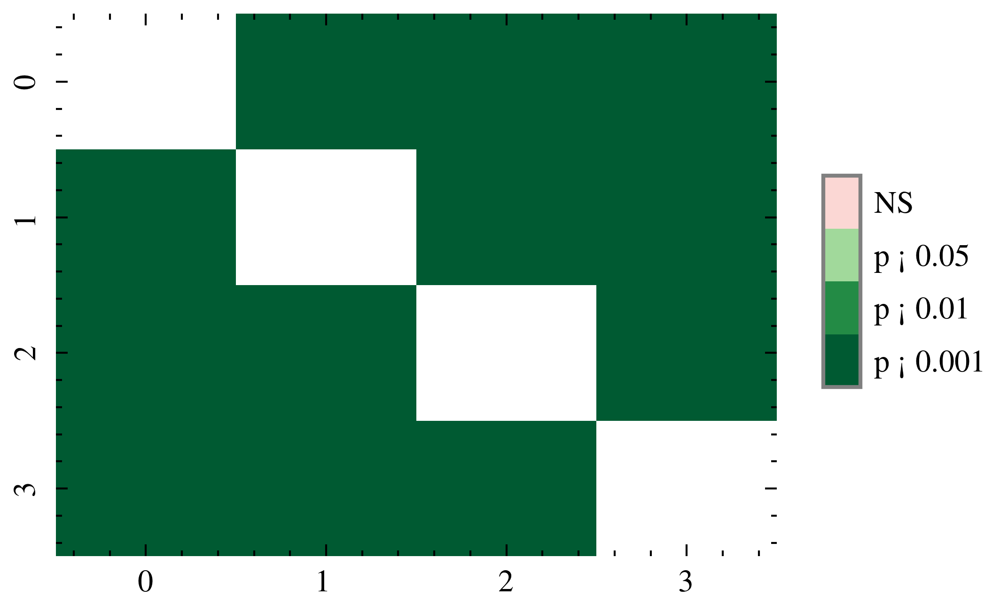

In [8]:
durbin_res, kruskal_test = get_posthoc_score("Boston, USA", service_time_df)
sign_plot(
    durbin_res,
)

print(kruskal_test)
durbin_res.round(3)

KruskalResult(statistic=171.01826874170007, pvalue=7.67067637363053e-37)


,0,1,2,3
0,1.0,0.000,0.000,0.000
1,0.0,1.000,0.333,0.004
2,0.0,0.333,1.000,0.004
3,0.0,0.004,0.004,1.000


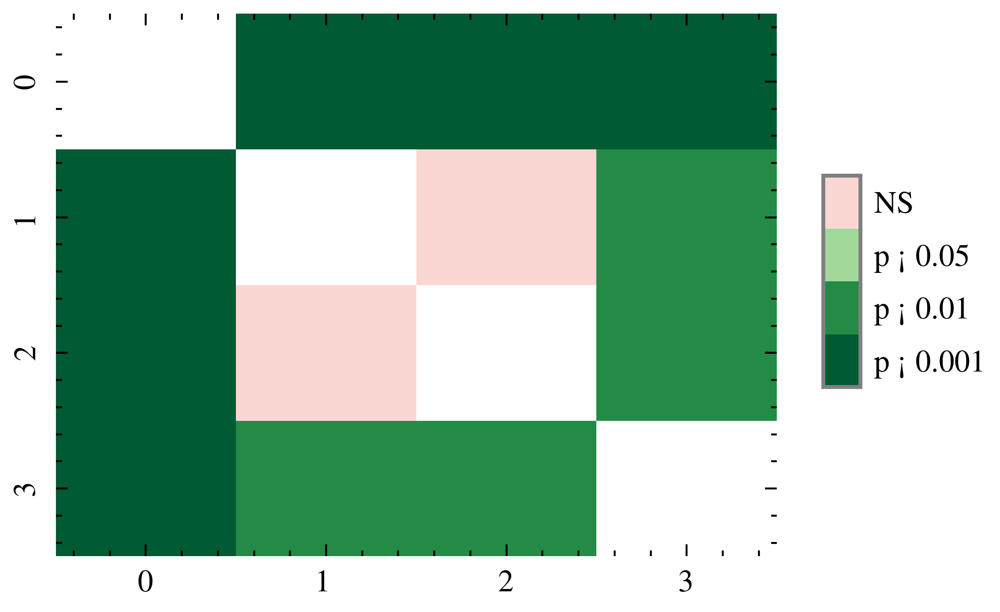

In [10]:
durbin_res, kruskal_test = get_posthoc_score("London, UK", service_time_df)
sign_plot(
    durbin_res,
)

print(kruskal_test)
durbin_res.round(3)

KruskalResult(statistic=3.42848023769398, pvalue=0.33015714255735784)


,0,1,2,3
0,1.000,1.0,0.958,1.0
1,1.000,1.0,1.000,1.0
2,0.958,1.0,1.000,1.0
3,1.000,1.0,1.000,1.0


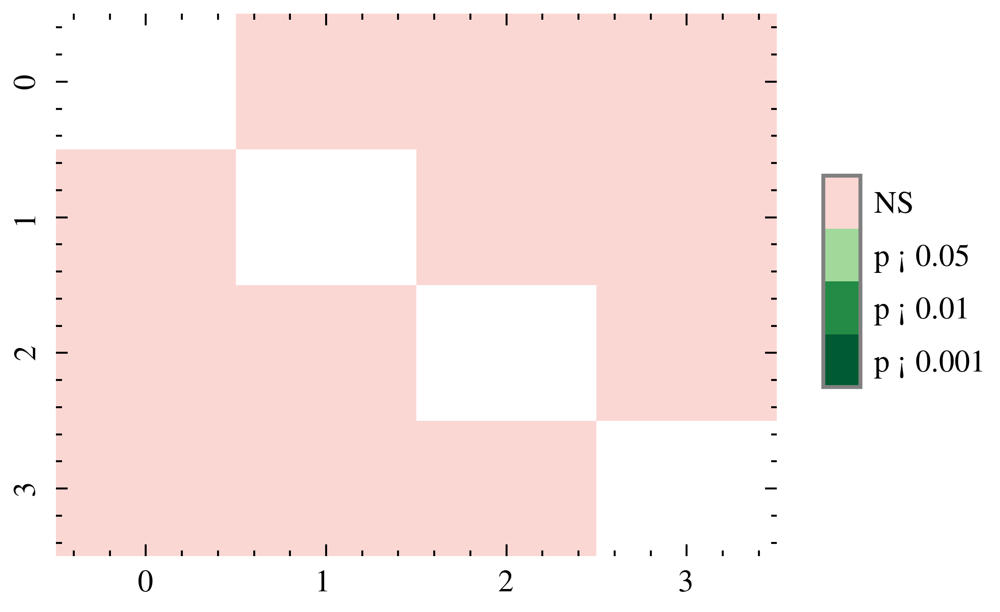

In [17]:
res, kruskal_test = get_posthoc_score("Brussels, Belgium", service_time_df)
sign_plot(
    res,
)
print(kruskal_test)
res.round(3)

               0             1              2              3
0   1.000000e+00  1.102359e-08  9.757329e-242  2.163736e-255
1   1.102359e-08  1.000000e+00   0.000000e+00   0.000000e+00
2  9.757329e-242  0.000000e+00   1.000000e+00   8.579979e-06
3  2.163736e-255  0.000000e+00   8.579979e-06   1.000000e+00


,0,1,2,3
0,1.0,0.0,0.0,0.0
1,0.0,1.0,0.0,0.0
2,0.0,0.0,1.0,0.0
3,0.0,0.0,0.0,1.0


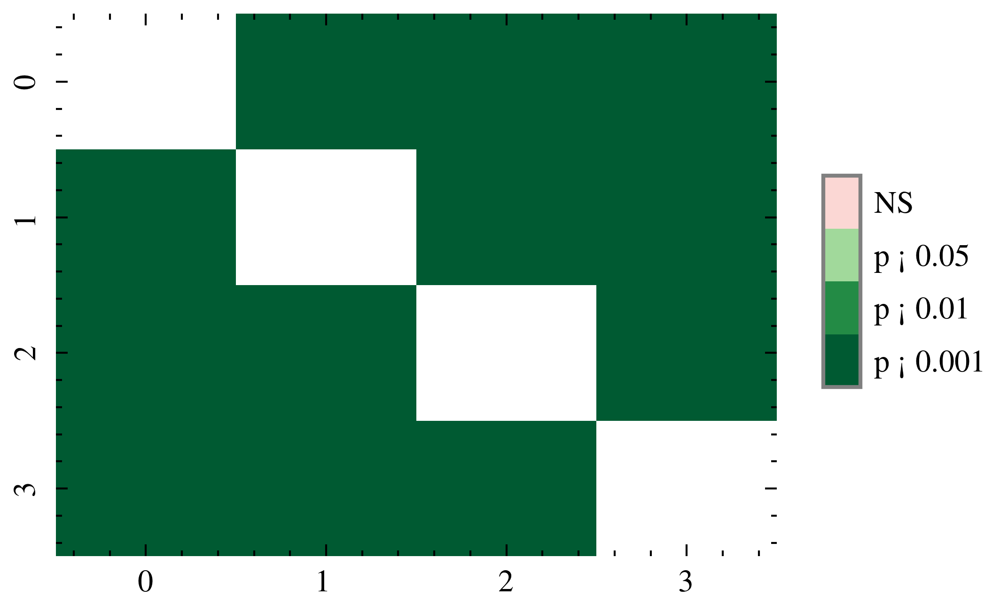

In [15]:
res, kruskal_test = get_posthoc_score("Chicago, USA", service_time_df)
sign_plot(
    res,
)

print(res)
res.round(3)

,0,1,2,3
0,1.0,0.0,0.000,0.000
1,0.0,1.0,0.000,0.000
2,0.0,0.0,1.000,0.003
3,0.0,0.0,0.003,1.000


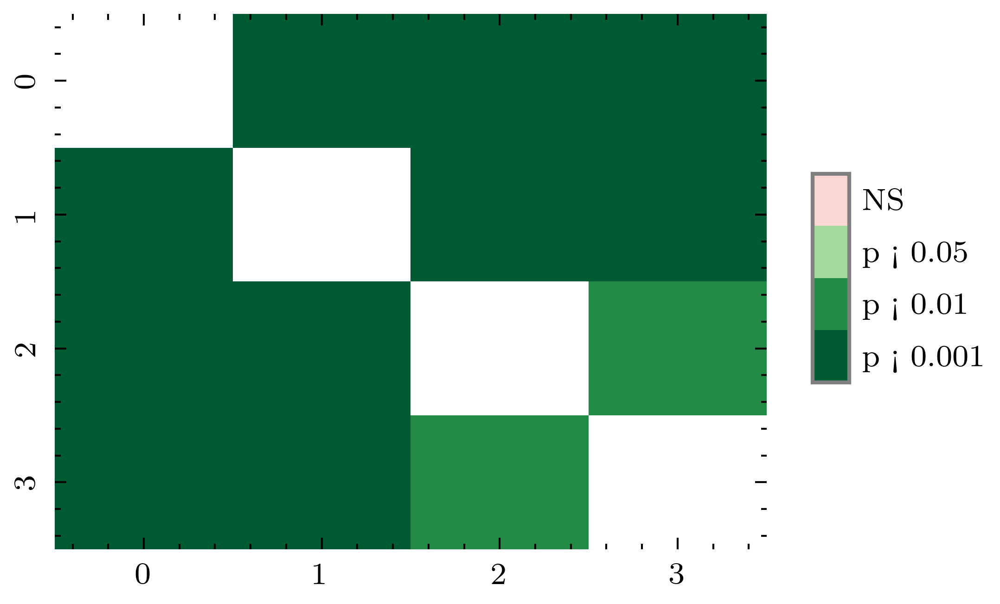

In [53]:
res = get_posthoc_score("Seattle, USA")
sign_plot(
    res,
)
res.round(3)